In [0]:
pip install imblearn

Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
from pyspark.mllib.evaluation import BinaryClassificationMetrics
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from pyspark.sql.functions import isnan, when, count, col
from pyspark.ml import Pipeline
from pyspark.ml.feature import OneHotEncoder, StringIndexer, VectorAssembler
from pyspark.ml.feature import Imputer
from pyspark.ml.feature import QuantileDiscretizer
import pandas as pd
from imblearn.over_sampling import ADASYN
from pyspark.ml.feature import StandardScaler
from pyspark.ml.linalg import DenseVector
from math import exp


In [0]:
df = spark.read.format("csv").option("inferSchema", "true").option("header", "true").option("sep", ',').option("nanValue", ' ').option("nullValue", ' ').load("dbfs:/FileStore/WA_Fn_UseC__Telco_Customer_Churn.csv")
display(df)

customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.3,1840.75,No
9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.7,151.65,Yes
9305-CDSKC,Female,0,No,No,8,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
1452-KIOVK,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.1,1949.4,No
6713-OKOMC,Female,0,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
7892-POOKP,Female,0,Yes,No,28,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.8,3046.05,Yes
6388-TABGU,Male,0,No,Yes,62,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No


In [0]:
 temp_table = "churn_analysis"
 df.createOrReplaceTempView(temp_table)

In [0]:
%sql
select * from churn_analysis

customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.3,1840.75,No
9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.7,151.65,Yes
9305-CDSKC,Female,0,No,No,8,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
1452-KIOVK,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.1,1949.4,No
6713-OKOMC,Female,0,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
7892-POOKP,Female,0,Yes,No,28,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.8,3046.05,Yes
6388-TABGU,Male,0,No,Yes,62,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No


In [0]:
 df.select('tenure', 'TotalCharges', 'MonthlyCharges').describe().show()

+-------+------------------+------------------+------------------+
|summary|            tenure|      TotalCharges|    MonthlyCharges|
+-------+------------------+------------------+------------------+
|  count|              7043|              7032|              7043|
|   mean| 32.37114865824223|2283.3004408418697| 64.76169246059922|
| stddev|24.559481023094442| 2266.771361883145|30.090047097678482|
|    min|                 0|              18.8|             18.25|
|    max|                72|            8684.8|            118.75|
+-------+------------------+------------------+------------------+



In [0]:
df.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in df.columns]).show()

+----------+------+-------------+-------+----------+------+------------+-------------+---------------+--------------+------------+----------------+-----------+-----------+---------------+--------+----------------+-------------+--------------+------------+-----+
|customerID|gender|SeniorCitizen|Partner|Dependents|tenure|PhoneService|MultipleLines|InternetService|OnlineSecurity|OnlineBackup|DeviceProtection|TechSupport|StreamingTV|StreamingMovies|Contract|PaperlessBilling|PaymentMethod|MonthlyCharges|TotalCharges|Churn|
+----------+------+-------------+-------+----------+------+------------+-------------+---------------+--------------+------------+----------------+-----------+-----------+---------------+--------+----------------+-------------+--------------+------------+-----+
|         0|     0|            0|      0|         0|     0|           0|            0|              0|             0|           0|               0|          0|          0|              0|       0|               0| 

In [0]:
df.groupBy('gender', 'churn').agg(count("*")).alias("count").show()

+------+-----+--------+
|gender|churn|count(1)|
+------+-----+--------+
|  Male|   No|    2625|
|  Male|  Yes|     930|
|Female|   No|    2549|
|Female|  Yes|     939|
+------+-----+--------+



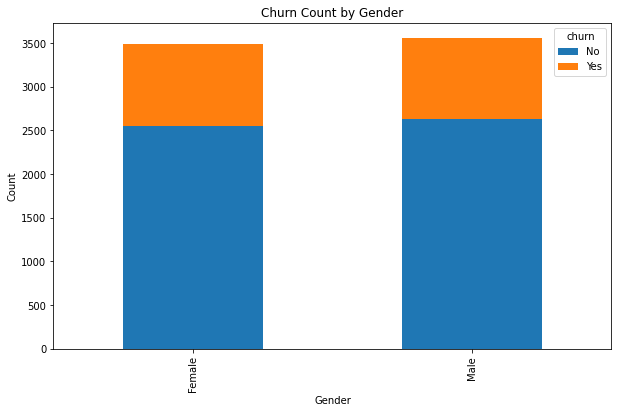

In [0]:
result = df.groupBy('gender', 'churn').agg(count("*").alias("count"))

# Convert the result to a Pandas DataFrame
result_pd = result.toPandas()

# Pivot the DataFrame to have 'churn' as columns
pivot_result = result_pd.pivot(index='gender', columns='churn', values='count')

# Plot the bar chart
ax = pivot_result.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Churn Count by Gender')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.show()

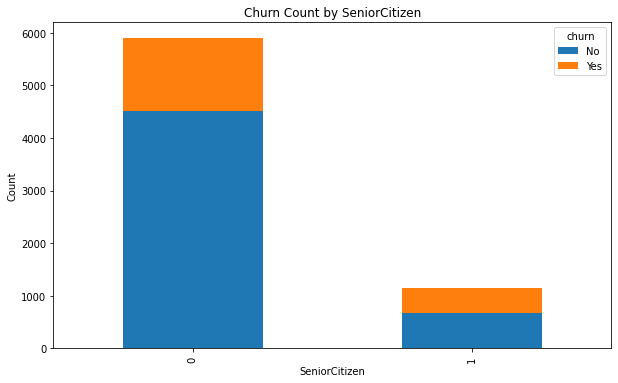

In [0]:
result = df.groupBy('SeniorCitizen', 'churn').agg(count("*").alias("count"))

# Convert the result to a Pandas DataFrame
result_pd = result.toPandas()

# Pivot the DataFrame to have 'churn' as columns
pivot_result = result_pd.pivot(index='SeniorCitizen', columns='churn', values='count')

# Plot the bar chart
ax = pivot_result.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Churn Count by SeniorCitizen')
plt.xlabel('SeniorCitizen')
plt.ylabel('Count')
plt.show()

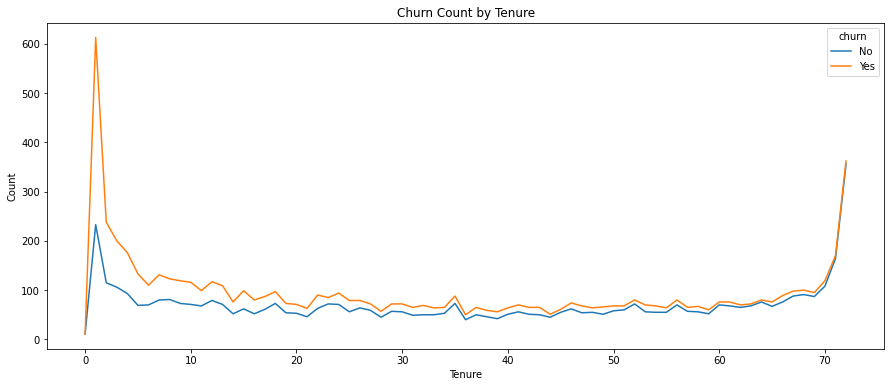

In [0]:
result = spark.sql("""
    SELECT CAST(tenure AS INT) AS tenure_int, churn, COUNT(churn) AS count
    FROM churn_analysis
    GROUP BY tenure, churn
    ORDER BY tenure_int
""")

# Convert the result to a Pandas DataFrame
result_pd = result.toPandas()

# Pivot the DataFrame to have 'churn' as columns
pivot_result = result_pd.pivot(index='tenure_int', columns='churn', values='count')

# Plot the bar chart
ax = pivot_result.plot(kind='line', stacked=True, figsize=(15, 6))
plt.title('Churn Count by Tenure')
plt.xlabel('Tenure')
plt.ylabel('Count')
plt.show()


In [0]:
df.stat.crosstab("SeniorCitizen", "InternetService").show()

+-----------------------------+----+-----------+----+
|SeniorCitizen_InternetService| DSL|Fiber optic|  No|
+-----------------------------+----+-----------+----+
|                            0|2162|       2265|1474|
|                            1| 259|        831|  52|
+-----------------------------+----+-----------+----+



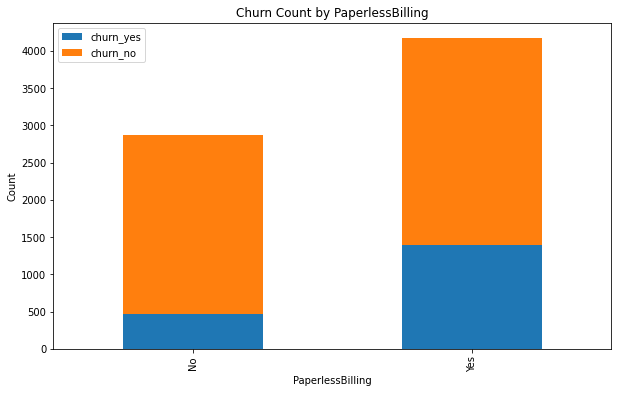

In [0]:
result = spark.sql("""
    SELECT PaperlessBilling,
           COUNT(CASE WHEN churn = 'Yes' THEN 1 ELSE NULL END) AS churn_yes,
           COUNT(CASE WHEN churn = 'No' THEN 1 ELSE NULL END) AS churn_no
    FROM churn_analysis
    GROUP BY PaperlessBilling
""")

# Convert the result to a Pandas DataFrame
result_pd = result.toPandas()

# Plot the bar chart
result_pd.plot(x='PaperlessBilling', kind='bar', stacked=True, figsize=(10, 6))
plt.title('Churn Count by PaperlessBilling')
plt.xlabel('PaperlessBilling')
plt.ylabel('Count')
plt.show()

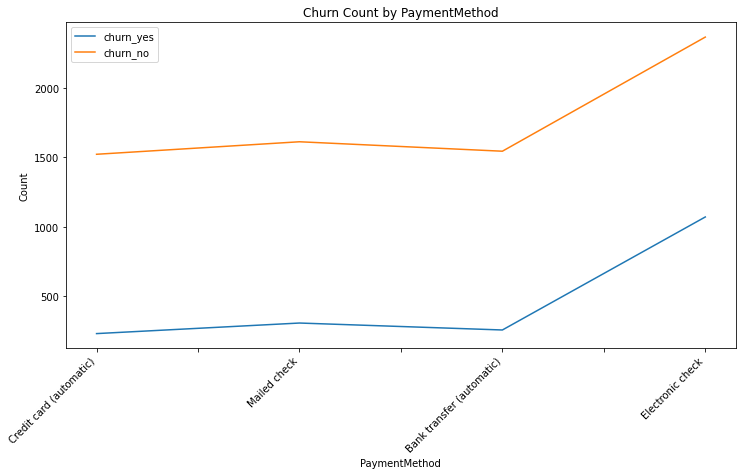

In [0]:
result = spark.sql("""
    SELECT PaymentMethod,
           COUNT(CASE WHEN churn = 'Yes' THEN 1 ELSE NULL END) AS churn_yes,
           COUNT(CASE WHEN churn = 'No' THEN 1 ELSE NULL END) AS churn_no
    FROM churn_analysis
    GROUP BY PaymentMethod
""")

# Convert the result to a Pandas DataFrame
result_pd = result.toPandas()

# Plot the bar chart
result_pd.plot(x='PaymentMethod', kind='line', stacked=True, figsize=(12, 6))
plt.title('Churn Count by PaymentMethod')
plt.xlabel('PaymentMethod')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.show()

In [0]:
df_churn = df
(train, test) = df_churn.randomSplit([0.7,0.3],  30)
print("Train Data:", train.count())
print("Test Data:", test.count())

Train Data: 4860
Test Data: 2183


In [0]:
stages = []
categorycols = ['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod']
for category in categorycols:
  stringIndexer = StringIndexer(inputCol = category, outputCol = category + "Index")
  encoder = OneHotEncoder(inputCols= [stringIndexer.getOutputCol()], outputCols= [category + "catVec"])
  stages += [stringIndexer, encoder]


imputer = Imputer(inputCols=["TotalCharges"], outputCols=['Out_TotalCharges'])
stages += [imputer]

labelIndex = StringIndexer(inputCol = "Churn", outputCol= "label")
stages += [labelIndex]


tenureBin = QuantileDiscretizer(numBuckets= 3, inputCol="tenure", outputCol="tenureBin")
stages += [tenureBin]

numericCols = ['tenureBin', 'Out_TotalCharges', 'MonthlyCharges']
assembleInputs = assemblerInputs = [c + "catVec" for c in categorycols] + numericCols
assembler = VectorAssembler(inputCols=assembleInputs, outputCol= "features")
stages += [assembler]



In [0]:
temp = labelIndex.fit(train).transform(train)
temp.display()

customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,label
0002-ORFBO,Female,0,Yes,Yes,9,Yes,No,DSL,No,Yes,No,Yes,Yes,No,One year,Yes,Mailed check,65.6,593.3,No,0.0
0013-MHZWF,Female,0,No,Yes,9,Yes,No,DSL,No,No,No,Yes,Yes,Yes,Month-to-month,Yes,Credit card (automatic),69.4,571.45,No,0.0
0013-SMEOE,Female,1,Yes,No,71,Yes,No,Fiber optic,Yes,Yes,Yes,Yes,Yes,Yes,Two year,Yes,Bank transfer (automatic),109.7,7904.25,No,0.0
0015-UOCOJ,Female,1,No,No,7,Yes,No,DSL,Yes,No,No,No,No,No,Month-to-month,Yes,Electronic check,48.2,340.35,No,0.0
0016-QLJIS,Female,0,Yes,Yes,65,Yes,Yes,DSL,Yes,Yes,Yes,Yes,Yes,Yes,Two year,Yes,Mailed check,90.45,5957.9,No,0.0
0017-DINOC,Male,0,No,No,54,No,No phone service,DSL,Yes,No,No,Yes,Yes,No,Two year,No,Credit card (automatic),45.2,2460.55,No,0.0
0018-NYROU,Female,0,Yes,No,5,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,68.95,351.5,No,0.0
0019-EFAEP,Female,0,No,No,72,Yes,Yes,Fiber optic,Yes,Yes,Yes,No,Yes,No,Two year,Yes,Bank transfer (automatic),101.3,7261.25,No,0.0
0020-INWCK,Female,0,Yes,Yes,71,Yes,Yes,Fiber optic,No,Yes,Yes,No,No,Yes,Two year,Yes,Credit card (automatic),95.75,6849.4,No,0.0
0020-JDNXP,Female,0,Yes,Yes,34,No,No phone service,DSL,Yes,No,Yes,Yes,Yes,Yes,One year,No,Mailed check,61.25,1993.2,No,0.0


In [0]:
 df.stat.corr("TotalCharges", "MonthlyCharges")

Out[21]: 0.6511738315787813

In [0]:
pipeline = Pipeline().setStages(stages)
pipelineModel = pipeline.fit(train)
train_df = pipelineModel.transform(train)
test_df = pipelineModel.transform(test)

In [0]:
train_rdd = train_df.rdd.map(lambda row: (row.features.toArray().tolist(), row.label))
df = spark.createDataFrame(train_rdd, ["features", "value"])
pdf = df.toPandas()  # Convert PySpark DataFrame to Pandas DataFrame
expanded_df = pd.concat([pdf, pdf['features'].apply(pd.Series)], axis=1).drop('features', axis=1)


test_rdd = test_df.rdd.map(lambda row: (row.features.toArray().tolist(), row.label))
df = spark.createDataFrame(test_rdd, ["features", "value"])
pdf = df.toPandas()
expandedtest_df = pd.concat([pdf, pdf['features'].apply(pd.Series)], axis=1).drop('features', axis=1)

expanded_df

,value,0,1,2,3,4,5,6,7,8,...,20,21,22,23,24,25,26,27,28,29
0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,593.30,65.60
1,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,...,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,571.45,69.40
2,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,...,1.0,0.0,1.0,1.0,0.0,0.0,1.0,2.0,7904.25,109.70
3,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,...,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,340.35,48.20
4,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,1.0,0.0,1.0,1.0,0.0,1.0,0.0,2.0,5957.90,90.45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4855,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,85.50,20.95
4856,1.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,...,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1873.70,85.10
4857,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,...,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,92.75,50.30
4858,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,4627.65,67.85


In [0]:
X_train = expanded_df[expanded_df.columns[1:]]
y_train = expanded_df['value']

X_test = expandedtest_df[expandedtest_df.columns[1:]]
y_test = expandedtest_df['value']

# The Dataset is highly skewed 
X_train = expanded_df[expanded_df.columns[1:]]
y_train = expanded_df['value']
oversample = ADASYN(random_state=42, sampling_strategy="minority")
X_train, y_train = oversample.fit_resample(X_train, y_train)

X_test = expandedtest_df[expanded_df.columns[1:]]
y_test = expandedtest_df['value']
oversample = ADASYN(random_state=42, sampling_strategy="minority")
X_test, y_test = oversample.fit_resample(X_test, y_test)

In [0]:
X_train['value'] = y_train
X_test['value'] = y_test

train_df = X_train

test_df = X_test

train_df['label'] = train_df['value']
train_df.drop('value', axis= 1, inplace= True)

test_df['label'] = test_df['value']
test_df.drop('value', axis= 1, inplace= True)

train_df = spark.createDataFrame(train_df)
test_df = spark.createDataFrame(test_df)

In [0]:
feature_cols = train_df.columns[:-1]
feature_cols = [str(i) for i in feature_cols]
vector_assembler = VectorAssembler(inputCols=feature_cols, outputCol="features")
train_df = vector_assembler.transform(train_df).select("features", "label")

testfeatures_cols = test_df.columns[:-1]
testfeatures_cols = [str(i) for i in testfeatures_cols]
test_vector_assembler = VectorAssembler(inputCols= testfeatures_cols, outputCol= "features")
test_df = test_vector_assembler.transform(test_df).select('features', 'label')



In [0]:
test_df.display()

features,label
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 6, 8, 9, 11, 13, 15, 17, 20, 21, 25, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 542.4, 59.9))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 7, 9, 11, 14, 15, 17, 19, 21, 23, 24, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 280.85, 73.9))",1.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 3, 4, 5, 7, 9, 12, 14, 15, 18, 20, 21, 23, 24, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1237.85, 98.0))",1.0
"Map(vectorType -> sparse, length -> 30, indices -> List(3, 4, 5, 7, 9, 11, 13, 16, 18, 19, 21, 23, 25, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 267.4, 83.9))",1.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 3, 4, 6, 7, 10, 11, 13, 16, 17, 19, 22, 23, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 5377.8, 84.65))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 6, 7, 10, 12, 14, 16, 18, 20, 22, 23, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 8456.75, 116.8))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 2, 3, 8, 10, 12, 14, 16, 17, 19, 22, 26, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2560.1, 45.05))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 6, 7, 9, 11, 13, 15, 18, 19, 21, 23, 24, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1849.95, 83.75))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 8, 10, 11, 13, 15, 17, 19, 21, 26, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 30.5, 30.5))",1.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 5, 7, 9, 12, 14, 16, 18, 20, 23, 26, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 5656.75, 103.7))",0.0


In [0]:
train_df.display()

features,label
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 5, 8, 9, 12, 13, 16, 18, 19, 23, 25, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 593.3, 65.6))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 2, 4, 5, 8, 9, 11, 13, 16, 18, 20, 21, 23, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 571.45, 69.4))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(3, 4, 5, 7, 10, 12, 14, 16, 18, 20, 22, 23, 26, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 7904.25, 109.7))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(2, 3, 4, 5, 8, 10, 11, 13, 15, 17, 19, 21, 23, 24, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 340.35, 48.2))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 23, 25, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 5957.9, 90.45))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 8, 10, 11, 13, 16, 18, 19, 22, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2460.55, 45.2))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 3, 4, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 24, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 351.5, 68.95))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 2, 3, 4, 6, 7, 10, 12, 14, 15, 18, 19, 22, 23, 26, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 7261.25, 101.3))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 6, 7, 9, 12, 14, 15, 17, 20, 22, 23, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 6849.4, 95.75))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 8, 10, 11, 14, 16, 18, 20, 25, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1993.2, 61.25))",0.0


In [0]:
scaler = StandardScaler(inputCol="features", outputCol="scaled_features", withStd=True, withMean=True)
scaler_model = scaler.fit(train_df)
train_df = scaler_model.transform(train_df)

test_scaler_model = scaler.fit(test_df)
test_df = scaler_model.transform(test_df)


In [0]:
train_df.display()

features,label,scaled_features
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 5, 8, 9, 12, 13, 16, 18, 19, 23, 25, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 593.3, 65.6))",0.0,"Map(vectorType -> dense, length -> 30, values -> List(-1.0833977143250888, 0.5241710186946053, -1.1399195343293174, -1.786646525129543, 0.34577798941130716, 1.1471536727048663, -0.93413126891274, -1.038284797539194, 1.490749227217488, 0.8771050266761043, -0.5998253484600037, -1.0312233742634098, 1.463962560378026, 1.0528541304662071, -0.7428406075360183, -1.2195662037746, 1.8003125416762455, -0.9006384340475144, 1.261323884706895, 1.1896291262617502, -0.8434808236065652, -1.3840275694714723, -0.46242360106012753, 0.7679860525552401, -0.8816232661484817, 2.053173654045032, -0.5237249609800474, -1.1501135927003432, -0.7179560042381127, -0.0703966602173197))"
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 2, 4, 5, 8, 9, 11, 13, 16, 18, 20, 21, 23, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 571.45, 69.4))",0.0,"Map(vectorType -> dense, length -> 30, values -> List(-1.0833977143250888, 0.5241710186946053, 0.9639140517324452, -1.786646525129543, 0.34577798941130716, 1.1471536727048663, -0.93413126891274, -1.038284797539194, 1.490749227217488, 0.8771050266761043, -0.5998253484600037, 1.058133848668784, -0.7469056098034319, 1.0528541304662071, -0.7428406075360183, -1.2195662037746, 1.8003125416762455, -0.9006384340475144, 1.261323884706895, -0.9088884475829258, 1.2743067013954208, 0.7557427010639012, -0.46242360106012753, 0.7679860525552401, -0.8816232661484817, -0.5179009824933953, -0.5237249609800474, -1.1501135927003432, -0.7277787538310481, 0.06054260495050285))"
"Map(vectorType -> sparse, length -> 30, indices -> List(3, 4, 5, 7, 10, 12, 14, 16, 18, 20, 22, 23, 26, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 7904.25, 109.7))",0.0,"Map(vectorType -> dense, length -> 30, values -> List(-1.0833977143250888, -2.1958358966904057, -1.1399195343293174, 0.6073185196805959, 0.34577798941130716, 1.1471536727048663, -0.93413126891274, 0.9907925879462389, -0.7005327402659777, -1.2248630109813636, 1.8122917558697096, -1.0312233742634098, 1.463962560378026, -1.026284532150181, 1.456322598474496, -1.2195662037746, 1.8003125416762455, -0.9006384340475144, 1.261323884706895, -0.9088884475829258, 1.2743067013954208, -1.3840275694714723, 2.1989434354727937, 0.7679860525552401, -0.8816232661484817, -0.5179009824933953, 2.0865845704309907, 1.3419304585372844, 2.5687090363326543, 1.4491879697566168))"
"Map(vectorType -> sparse, length -> 30, indices -> List(2, 3, 4, 5, 8, 10, 11, 13, 15, 17, 19, 21, 23, 24, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 340.35, 48.2))",0.0,"Map(vectorType -> dense, length -> 30, values -> List(-1.0833977143250888, -2.1958358966904057, 0.9639140517324452, 0.6073185196805959, 0.34577798941130716, 1.1471536727048663, -0.93413126891274, -1.038284797539194, 1.490749227217488, -1.2248630109813636, 1.8122917558697096, 1.058133848668784, -0.7469056098034319, 1.0528541304662071, -0.7428406075360183, 0.879180916537604, -0.6010686905130265, 1.2009446088821918, -0.8508851082615958, 1.1896291262617502, -0.8434808236065652, 0.7557427010639012, -0.46242360106012753, 0.7679860525552401, 1.2585662456526983, -0.5179009824933953, -0.5237249609800474, -1.1501135927003432, -0.8316706271000357, -0.6699606638805051))"
"Map(vectorType -> sparse, length -> 30, indices -> List(1, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 23, 25, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 5957.9, 90.45))",0.0,"Map(vectorType -> dense, length -> 30, values -> List(-1.0833977143250888, 0.5241710186946053, -1.1399195343293174, -1.786646525129543, 0.34577798941130716, -0.9448578647155121, 1.1496352334152637, -1.038284797539194, 

In [0]:
test_df.display()

features,label,scaled_features
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 6, 8, 9, 11, 13, 15, 17, 20, 21, 25, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 542.4, 59.9))",0.0,"Map(vectorType -> dense, length -> 30, values -> List(1.0284299435252466, 0.5241710186946053, 0.9639140517324452, 0.6073185196805959, 0.34577798941130716, -0.9448578647155121, 1.1496352334152637, -1.038284797539194, 1.490749227217488, 0.8771050266761043, -0.5998253484600037, 1.058133848668784, -0.7469056098034319, 1.0528541304662071, -0.7428406075360183, 0.879180916537604, -0.6010686905130265, 1.2009446088821918, -0.8508851082615958, -0.9088884475829258, 1.2743067013954208, 0.7557427010639012, -0.46242360106012753, -1.410724499069194, -0.8816232661484817, 2.053173654045032, -0.5237249609800474, -1.1501135927003432, -0.7408382904752026, -0.2668055579690528))"
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 7, 9, 11, 14, 15, 17, 19, 21, 23, 24, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 280.85, 73.9))",1.0,"Map(vectorType -> dense, length -> 30, values -> List(1.0284299435252466, 0.5241710186946053, 0.9639140517324452, 0.6073185196805959, 0.34577798941130716, 1.1471536727048663, -0.93413126891274, 0.9907925879462389, -0.7005327402659777, 0.8771050266761043, -0.5998253484600037, 1.058133848668784, -0.7469056098034319, -1.026284532150181, 1.456322598474496, 0.879180916537604, -0.6010686905130265, 1.2009446088821918, -0.8508851082615958, 1.1896291262617502, -0.8434808236065652, 0.7557427010639012, -0.46242360106012753, 0.7679860525552401, 1.2585662456526983, -0.5179009824933953, -0.5237249609800474, -1.1501135927003432, -0.8584190756483038, 0.21560226107029226))"
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 3, 4, 5, 7, 9, 12, 14, 15, 18, 20, 21, 23, 24, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1237.85, 98.0))",1.0,"Map(vectorType -> dense, length -> 30, values -> List(1.0284299435252466, -2.1958358966904057, -1.1399195343293174, 0.6073185196805959, 0.34577798941130716, 1.1471536727048663, -0.93413126891274, 0.9907925879462389, -0.7005327402659777, 0.8771050266761043, -0.5998253484600037, -1.0312233742634098, 1.463962560378026, -1.026284532150181, 1.456322598474496, 0.879180916537604, -0.6010686905130265, -0.9006384340475144, 1.261323884706895, -0.9088884475829258, 1.2743067013954208, 0.7557427010639012, -0.46242360106012753, 0.7679860525552401, 1.2585662456526983, -0.5179009824933953, -0.5237249609800474, -1.1501135927003432, -0.4281961300904455, 1.0460328638451641))"
"Map(vectorType -> sparse, length -> 30, indices -> List(3, 4, 5, 7, 9, 11, 13, 16, 18, 19, 21, 23, 25, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 267.4, 83.9))",1.0,"Map(vectorType -> dense, length -> 30, values -> List(-1.0833977143250888, -2.1958358966904057, -1.1399195343293174, 0.6073185196805959, 0.34577798941130716, 1.1471536727048663, -0.93413126891274, 0.9907925879462389, -0.7005327402659777, 0.8771050266761043, -0.5998253484600037, 1.058133848668784, -0.7469056098034319, 1.0528541304662071, -0.7428406075360183, -1.2195662037746, 1.8003125416762455, -0.9006384340475144, 1.261323884706895, 1.1896291262617502, -0.8434808236065652, 0.7557427010639012, -0.46242360106012753, 0.7679860525552401, -0.8816232661484817, 2.053173654045032, -0.5237249609800474, -1.1501135927003432, -0.8644655736814836, 0.5601792746698242))"
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 3, 4, 6, 7, 10, 11, 13, 16, 17, 19, 22, 23, 27, 28, 29), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 5377.8, 84.65))",0.0,"Map(vectorType -> dense, length -> 30, values -> List(1.0284299435252466, 0.5241710186946053, -1.1399195343293174, 0.6073185196805959, 0.34577798941130716, -0.94485786471

In [0]:
train_rdd = train_df.rdd.map(lambda row: (DenseVector(row.scaled_features.toArray()), row.label))
test_rdd = test_df.rdd.map(lambda row: (DenseVector(row.scaled_features.toArray()), row.label))


In [0]:
train_rdd.collect()
test_rdd.collect()

Out[34]: [(DenseVector([1.0284, 0.5242, 0.9639, 0.6073, 0.3458, -0.9449, 1.1496, -1.0383, 1.4907, 0.8771, -0.5998, 1.0581, -0.7469, 1.0529, -0.7428, 0.8792, -0.6011, 1.2009, -0.8509, -0.9089, 1.2743, 0.7557, -0.4624, -1.4107, -0.8816, 2.0532, -0.5237, -1.1501, -0.7408, -0.2668]),
  0.0),
 (DenseVector([1.0284, 0.5242, 0.9639, 0.6073, 0.3458, 1.1472, -0.9341, 0.9908, -0.7005, 0.8771, -0.5998, 1.0581, -0.7469, -1.0263, 1.4563, 0.8792, -0.6011, 1.2009, -0.8509, 1.1896, -0.8435, 0.7557, -0.4624, 0.768, 1.2586, -0.5179, -0.5237, -1.1501, -0.8584, 0.2156]),
  1.0),
 (DenseVector([1.0284, -2.1958, -1.1399, 0.6073, 0.3458, 1.1472, -0.9341, 0.9908, -0.7005, 0.8771, -0.5998, -1.0312, 1.464, -1.0263, 1.4563, 0.8792, -0.6011, -0.9006, 1.2613, -0.9089, 1.2743, 0.7557, -0.4624, 0.768, 1.2586, -0.5179, -0.5237, -1.1501, -0.4282, 1.046]),
  1.0),
 (DenseVector([-1.0834, -2.1958, -1.1399, 0.6073, 0.3458, 1.1472, -0.9341, 0.9908, -0.7005, 0.8771, -0.5998, 1.0581, -0.7469, 1.0529, -0.7428, -1.2196, 1.800

In [0]:
def sigmoid(z):
    z = max(min(z, 20), -20)
    return 1 / (1 + exp(-float(z)))

def logistic_regression(data, num_iterations, learning_rate):
    weights = DenseVector([0.0] * len(data.first()[0]))
    regularization = 0.01
    for _ in range(num_iterations):
        gradient = data.map(lambda d: ((sigmoid(weights.dot(d[0])) - d[1]) * d[0]) + regularization * weights).mean()
        
        gradient = gradient.toArray()
        gradient[0] -= regularization * weights[0]

        weights -= learning_rate * gradient
    
    return weights

num_iterations = 100
learning_rate = 0.02
weights = logistic_regression(train_rdd, num_iterations, learning_rate)



Accuracy: 0.7457627118644068


/databricks/spark/python/pyspark/sql/context.py:165: FutureWarning: Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.
  warnings.warn(


Area under ROC curve (AUC): 0.8183129077069952
Area under precision-recall curve (AUC-PR): 0.7823551603321831


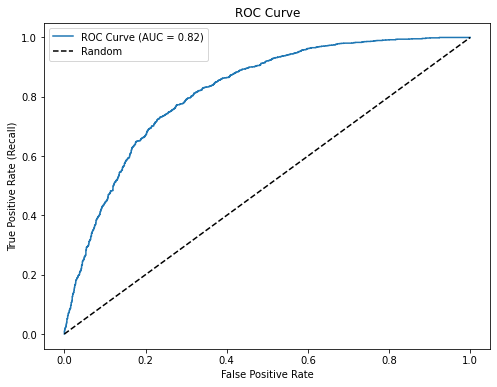

In [0]:

def predict(features):
    return sigmoid(weights.dot(features))

predictions_rdd = train_rdd.map(lambda x: (predict(x[0]), x[1]))
accuracy = predictions_rdd.filter(lambda x: (x[0] >= 0.5) == x[1]).count() / float(train_rdd.count())
print(f"Accuracy: {accuracy}")

scores_and_labels = test_df.rdd.map(lambda row: (float(weights.dot(row.scaled_features)), row.label))

metrics = BinaryClassificationMetrics(scores_and_labels)

# Print various metrics
print(f"Area under ROC curve (AUC): {metrics.areaUnderROC}")
print(f"Area under precision-recall curve (AUC-PR): {metrics.areaUnderPR}")


scores_and_labels = test_df.rdd.map(lambda row: (float(weights.dot(row.scaled_features)), row.label)).collect()
scores, labels = zip(*scores_and_labels)
fpr, tpr, _ = roc_curve(labels, scores)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate (Recall)')
plt.title('ROC Curve')
plt.legend()
plt.show()


